<a href="https://colab.research.google.com/github/gss223/perceiver/blob/main/Perceiver/Perceiver_for_Multimodal_Autoencoding.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Set-up environment

First, we install HuggingFace Transformers.

In [ ]:
!pip install -q git+https://github.com/huggingface/transformers.git

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done


## Helper functions for the UCF101 dataset

Here we define some utilities, useful for working with video.

In [ ]:
import base64
import functools
import os
import pickle
import ssl
import re
import tempfile

from urllib import request

import cv2
import imageio
import numpy as np
import scipy.io.wavfile

from IPython.display import HTML

In [ ]:
# Utilities to fetch videos from UCF101 dataset
UCF_ROOT = 'https://www.crcv.ucf.edu/THUMOS14/UCF101/UCF101/'
_VIDEO_LIST = None
_CACHE_DIR = tempfile.mkdtemp()
# As of July 2020, crcv.ucf.edu doesn't use a certificate accepted by the
# default Colab environment anymore.
unverified_context = ssl._create_unverified_context()

def list_ucf_videos():
  """Lists videos available in UCF101 dataset."""
  global _VIDEO_LIST
  if not _VIDEO_LIST:
    index = request.urlopen(UCF_ROOT, context=unverified_context).read().decode('utf-8')
    videos = re.findall('(v_[\w_]+\.avi)', index)
    _VIDEO_LIST = sorted(set(videos))
  return list(_VIDEO_LIST)

def fetch_ucf_video(video):
  """Fetchs a video and cache into local filesystem."""
  cache_path = os.path.join(_CACHE_DIR, video)
  if not os.path.exists(cache_path):
    urlpath = request.urljoin(UCF_ROOT, video)
    print('Fetching %s => %s' % (urlpath, cache_path))
    data = request.urlopen(urlpath, context=unverified_context).read()
    open(cache_path, "wb").write(data)
  return cache_path

# Utilities to open video files using CV2
def crop_center_square(frame):
  y, x = frame.shape[0:2]
  min_dim = min(y, x)
  start_x = (x // 2) - (min_dim // 2)
  start_y = (y // 2) - (min_dim // 2)
  return frame[start_y:start_y+min_dim,start_x:start_x+min_dim]

def load_video(path, max_frames=0, resize=(224, 224)):
  cap = cv2.VideoCapture(path)
  frames = []
  try:
    while True:
      ret, frame = cap.read()
      if not ret:
        break
      frame = crop_center_square(frame)
      frame = cv2.resize(frame, resize)
      frame = frame[:, :, [2, 1, 0]]
      frames.append(frame)
      
      if len(frames) == max_frames:
        break
  finally:
    cap.release()
  return np.array(frames) / 255.0

def to_gif(images):
  converted_images = np.clip(images * 255, 0, 255).astype(np.uint8)
  imageio.mimsave('./animation.gif', converted_images, fps=25)
  with open('./animation.gif', 'rb') as f:
    gif_64 = base64.b64encode(f.read()).decode('utf-8')
  return HTML('<img src="data:image/gif;base64,%s"/>' % gif_64)

def play_audio(data, sample_rate=48000):
  scipy.io.wavfile.write('tmp_audio.wav', sample_rate, data)

  with open('./tmp_audio.wav', 'rb') as f:
    audio_64 = base64.b64encode(f.read()).decode('utf-8')
  return HTML('<audio controls src="data:audio/wav;base64,%s"/>' % audio_64)

def table(elements):
  row = ['<td>%s</td>' % el.data for el in elements]
  return HTML('<table><tr>%s</tr></table>' % ''.join(row))

## Load video and audio from UCF

Here we load a particular video, which we'll use for auto-encoding.

In [ ]:
video_names = list_ucf_videos()
video_path = fetch_ucf_video(video_names[0])

# Extract audio using FFMPEG and encode as pcm float wavfile (only format readable by scipy.io.wavfile).
!yes | ffmpeg -i "$video_path"  -c copy  -f wav -map 0:a pcm_f32le -ar 48000 output.wav

sample_rate, audio = scipy.io.wavfile.read("output.wav")
if audio.dtype == np.int16:
  audio = audio.astype(np.float32) / 2**15
elif audio.dtype != np.float32:
  raise ValueError('Unexpected datatype. Model expects sound samples to lie in [-1, 1]')

video = load_video(video_path)

Fetching https://www.crcv.ucf.edu/THUMOS14/UCF101/UCF101/v_ApplyEyeMakeup_g01_c01.avi => /tmp/tmpavy3o1ng/v_ApplyEyeMakeup_g01_c01.avi
ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame 

""

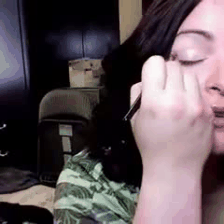

In [ ]:
# Visualize inputs
table([to_gif(video), play_audio(audio)])

## Apply

Note that the entire video (i.e. all 16 frames) is used in the forward pass of the model (to perform cross-attention with the latents).

However, only certain subsampled index dimensions are used when creating the decoder queries. 

In [ ]:
from transformers import PerceiverForMultimodalAutoencoding
from tqdm.notebook import tqdm
import torch

device = 'cuda' if torch.cuda.is_available() else 'cpu'

model = PerceiverForMultimodalAutoencoding.from_pretrained("deepmind/multimodal-perceiver", 
                                                                   low_cpu_mem_usage=True)
model.to(device)

def autoencode_video(images, audio):
  
  # only create entire video once as inputs
  inputs = {'image': torch.from_numpy(np.moveaxis(images, -1, 2)).float().to(device),
          'audio': torch.from_numpy(audio).to(device),
          'label': torch.zeros((images.shape[0], 700)).to(device)}
  
  nchunks = 128
  reconstruction = {}
  for chunk_idx in tqdm(range(nchunks)):
        image_chunk_size = np.prod(images.shape[1:-1]) // nchunks
        audio_chunk_size = audio.shape[1] // SAMPLES_PER_PATCH // nchunks
        subsampling = {
            'image': torch.arange(
                image_chunk_size * chunk_idx, image_chunk_size * (chunk_idx + 1)),
            'audio': torch.arange(
                audio_chunk_size * chunk_idx, audio_chunk_size * (chunk_idx + 1)),
            'label': None,
        }
        
        # forward pass
        with torch.no_grad():
          outputs = model(inputs=inputs, subsampled_output_points=subsampling)

        output = {k:v.cpu() for k,v in outputs.logits.items()}
        
        reconstruction['label'] = output['label']
        if 'image' not in reconstruction:
          reconstruction['image'] = output['image']
          reconstruction['audio'] = output['audio']
        else:
          reconstruction['image'] = torch.cat(
              [reconstruction['image'], output['image']], dim=1)
          reconstruction['audio'] = torch.cat(
              [reconstruction['audio'], output['audio']], dim=1)
          
        del outputs
        
  # finally, reshape image and audio modalities back to original shape
  reconstruction['image'] = torch.reshape(reconstruction['image'], images.shape)
  reconstruction['audio'] = torch.reshape(reconstruction['audio'], audio.shape)
  return reconstruction

  return None

In [ ]:
AUDIO_SAMPLES_PER_FRAME = 48000 // 25
SAMPLES_PER_PATCH = 16

# Auto-encode the first 16 frames of the video and one of the audio channels
reconstruction = autoencode_video(video[None, :16], audio[None, :16*AUDIO_SAMPLES_PER_FRAME, 0:1])

  0%|          | 0/128 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


""

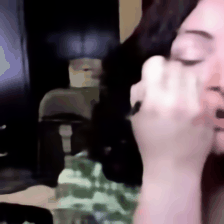

In [ ]:
# Visualize reconstruction of first 16 frames
table([to_gif(reconstruction["image"][0].numpy()), play_audio(np.array(reconstruction["audio"][0].numpy()))])

""

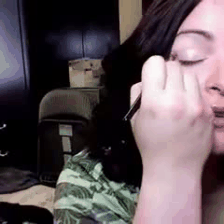

In [ ]:
table([to_gif(video), play_audio(audio)])

In [ ]:
# Print top 5 predicted labels
scores, indices = torch.topk(torch.softmax(reconstruction["label"], dim=1), k=5)
for score, index in zip(scores[0], indices[0]):
  print("%s: %s" % (model.config.id2label[index.item()], score.item()))

putting on foundation: 0.23479609191417694
dyeing eyebrows: 0.12428657710552216
scrubbing face: 0.09868372231721878
filling eyebrows: 0.061013758182525635
dyeing hair: 0.03654387965798378
